# Training Data Collection

This notebook is used to create a training dataset to estimate snow depth from landsat data. The ground truth data is from SNOTEL stations.

Steps:
1. Setup: Selecting a station and setting some other constants
2. Use the lat/lon of the station to find landsat items, going back to 2004 (the furtherst back the SNOTEL API goes).
3. Use dates of those landsat items to query for snow depth data from the SNOTEL API.
4. Select band data from those landsat items at the lat/lon of the station (so the band data is associated with the nearest snow depth measurement)
5. Save data to a parquet file.

## Imports


In [1]:
import folium
import gc
from IPython.display import HTML
import fsspec
import pandas as pd
import pyarrow as pa
import pyarrow.parquet as pq
from pystac_client import Client
from typing import Dict, Any
from concurrent.futures import ThreadPoolExecutor, as_completed

import data_classes
import plotting

/usr/local/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Set constants

In [ ]:
# Get lat/lon of SNOTEL stations
snotel_stations = pd.read_json("snotel-wa-stations.json")
snotel_api = "https://wcc.sc.egov.usda.gov/awdbRestApi/services/v1/data"
# 1085, 642, 1257 done
station_triplet = "679:WA:SNTL"
station_data = snotel_stations[snotel_stations.stationTriplet == station_triplet]
station_lat, station_lon = station_data.latitude.values[0], station_data.longitude.values[0]
# elevation = station_data.elevation.values[0]
start_date, end_date = '2004-01-01', '2025-06-01'
stac_api = "https://landsatlook.usgs.gov/stac-server"
collections =  ["landsat-c2ard-sr"] # "landsat-c2l3-fsca" will also be used for snow cover fraction
fs = fsspec.filesystem("s3", anon=False, requester_pays=True)
parquet_file = 'snotel_data.parquet'


## 2. Search for landsat items

In [3]:
client = Client.open(stac_api)
station_buffer = 0.1
landsat_item_search = client.search(
    collections=collections,
    bbox=(station_lon-station_buffer, station_lat-station_buffer, station_lon+station_buffer, station_lat+station_buffer),
    datetime=(start_date, end_date)
)

print(f"Found {landsat_item_search.matched()} items")
landsat_items = landsat_item_search.item_collection()

1743

### Sidebar: Display HLS data and station

It is always helpful to visually inspect data to make sure we are on the right track!


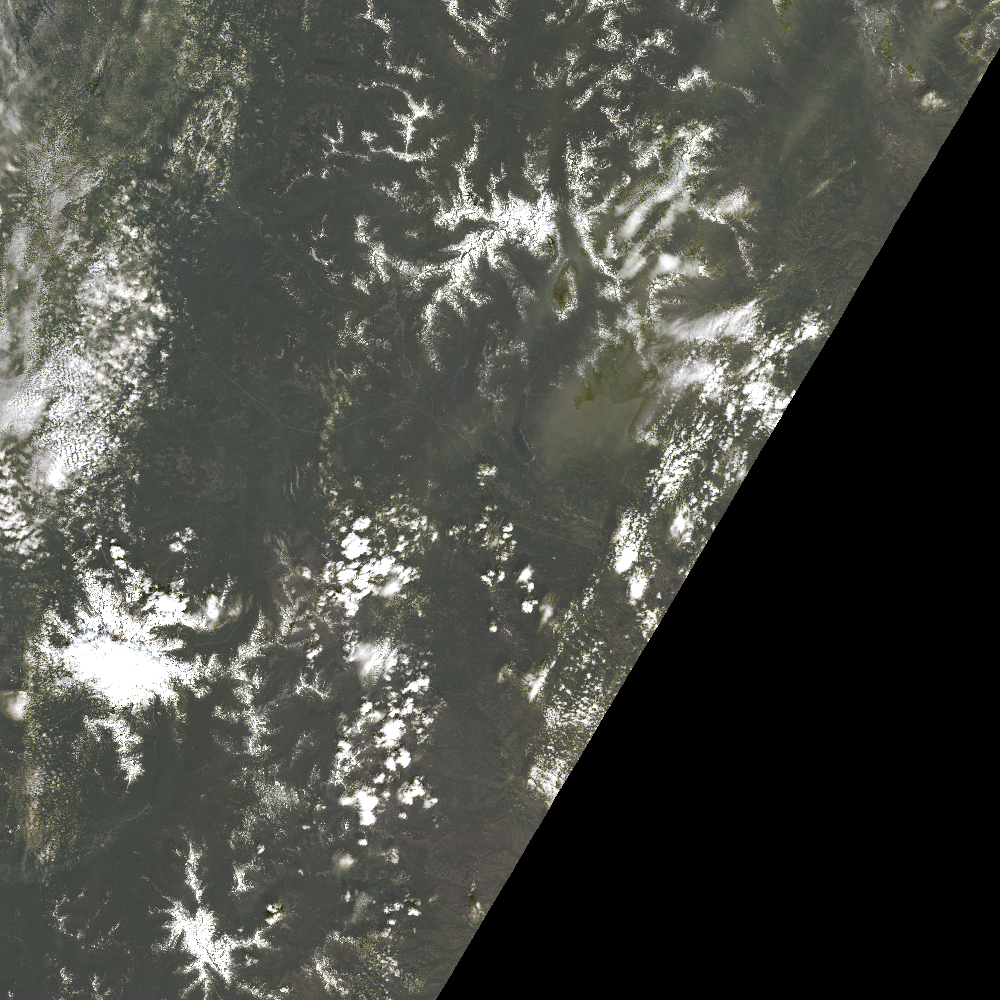

In [6]:
first_landsat_item = landsat_items[1]

# Create the map
m = folium.Map(
    location=[station_lat, station_lon],
    zoom_start=7,
    tiles='OpenStreetMap'
)

red = plotting.get_band_data(fs, first_landsat_item, 'red')
green = plotting.get_band_data(fs, first_landsat_item, 'green')
blue =plotting.get_band_data(fs, first_landsat_item, 'blue')
folium.raster_layers.ImageOverlay(
    name='True Color Image',
    image=f'data:image/png;base64,{plotting.rgb_image_str(red, green, blue)}',
    bounds=plotting.get_item_bounds(first_landsat_item),
    opacity=0.8,
    popup='HLS True Color Image'
).add_to(m)

folium.CircleMarker(
    location=[station_lat, station_lon],
    radius=5,
    color='green',
    fill=True,
    fillOpacity=0.7
).add_to(m)

# Display with custom size using HTML
html = m._repr_html_()
html_with_size = f'<div style="width: 500px; height: 500px;">{html}</div>'
HTML(html_with_size)

## 3. Create Parquet Schame and Table

Only create the table if it doesn't exist already

In [ ]:
schema = pa.schema([
    pa.field('date', pa.string()),
    pa.field('snow_depth', pa.int64(), nullable=True),
    pa.field('red', pa.int64(), nullable=True),
    pa.field('green', pa.int64(), nullable=True),
    pa.field('blue', pa.int64(), nullable=True),
    pa.field('coastal', pa.float64(), nullable=True),
    pa.field('nir08', pa.int64(), nullable=True),
    pa.field('swir16', pa.int64(), nullable=True),
    pa.field('swir22', pa.int64(), nullable=True),
    pa.field('fsca', pa.float64(), nullable=True),
    pa.field('item_id', pa.string()),
    pa.field('station_triplet', pa.string()), 
    pa.field('latitude', pa.float64()),
    pa.field('longitude', pa.float64()),
    # pa.field('elevation', pa.float64())
])

In [8]:
create_new = False
if create_new == True:
    empty_table = schema.empty_table()
    pq.write_table(empty_table, parquet_file)

In [24]:
# Function for appending new data to parquet file
def append_items(file_path, new_data):
    new_table = pa.table(new_data, schema=schema)
    
    # Read existing data and append
    existing_table = pq.read_table(file_path)
    combined_table = pa.concat_tables([existing_table, new_table])
    
    # Write back to file
    pq.write_table(combined_table, file_path)

## 4. Load data from both landsat (band data) and SNOTEL API (ground truth) and store it in the table

1. Get SNOTEL snow depth data for the same date as each landsat scene
2. Read band data for the lat/lon of the SNOTEL data
3. Write data to the parquet table

In [ ]:
def flatten_list(list_of_lists: list[list[Any]]) -> list[Any]:
    return [item for sublist in list_of_lists for item in sublist]

def process_item_parallel(args: tuple) -> Dict[str, Any]:
    """Process a single item in parallel"""
    fs, item, lat, lon, station_triplet = args
    extractor = data_classes.HLSDataExtractor(fs=fs, item=item)
    ground_truth = data_classes.SNOTELProvider(
        station_triplet=station_triplet,
        latitude=lat,
        longitude=lon
    )
    manager = data_classes.SatelliteDataManager(
        extractor=extractor,
        ground_truth_provider=ground_truth
    )    
    training_points = manager.extract_training_data([(lat, lon)])
    return manager.filter_valid_training_data(training_points)

In [25]:
# # to test
# result = process_item_parallel((fs, first_landsat_item, station_lat, station_lon, station_triplet))
# append_items(parquet_file, data_classes.for_parquet_insert(result))

In [27]:
batch_size = 10
start_idx = 1
end_idx = len(landsat_items)
max_workers = 10

for i in range(start_idx, end_idx, batch_size):
    args_list = [(fs, item, station_lat, station_lon, station_triplet) for item in landsat_items[i:i+batch_size]]
    print(f"Processing items {i} to {i+batch_size} of {len(landsat_items)}")
    results = []

    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        # Submit all tasks
        future_to_item = {
            executor.submit(process_item_parallel, args): args[1] 
            for args in args_list
        }
        
        # Process completed tasks
        for future in as_completed(future_to_item):
            item = future_to_item[future]
            try:
                result = future.result()
                if result is not None:
                    results.append(result)
            except Exception as e:
                print(f"Error processing item {item.id}: {e}")

    append_items(parquet_file, data_classes.for_parquet_insert(flatten_list(results)))
    gc.collect()


Processing items 1 to 11 of 1743
Processing items 11 to 21 of 1743
Processing items 21 to 31 of 1743
Processing items 31 to 41 of 1743
Processing items 41 to 51 of 1743
Processing items 51 to 61 of 1743
Processing items 61 to 71 of 1743
Processing items 71 to 81 of 1743
Processing items 81 to 91 of 1743
Processing items 91 to 101 of 1743
Processing items 101 to 111 of 1743
Processing items 111 to 121 of 1743
Processing items 121 to 131 of 1743
Error getting SNOTEL data: Expecting value: line 1 column 1 (char 0)
Processing items 131 to 141 of 1743
Processing items 141 to 151 of 1743
Processing items 151 to 161 of 1743
Processing items 161 to 171 of 1743
Processing items 171 to 181 of 1743
Processing items 181 to 191 of 1743
Processing items 191 to 201 of 1743
Processing items 201 to 211 of 1743
Processing items 211 to 221 of 1743
Processing items 221 to 231 of 1743
Processing items 231 to 241 of 1743
Processing items 241 to 251 of 1743
Processing items 251 to 261 of 1743
Processing item

In [16]:
df = pd.read_parquet(parquet_file)
df

,date,snow_depth,red,green,blue,coastal,nir08,swir16,swir22,fsca,item_id,station_triplet
0,2025-05-10T18:49:15.298686Z,87,23783,24067,24563,24717.0,24915,16878,17017,539.0,LC08_CU_004002_20250510_20250518_02_SR,1085:WA:SNTL
1,2025-05-26T18:49:08.643245Z,64,30420,30484,31724,31765.0,30553,22723,18696,531.0,LC08_CU_004002_20250526_20250606_02_SR,1085:WA:SNTL
2,2025-04-24T18:49:03.983677Z,121,20230,20543,20727,19248.0,21290,8042,7762,742.0,LC08_CU_004002_20250424_20250503_02_SR,1085:WA:SNTL
3,2025-05-01T18:55:04.333565Z,109,20102,19735,20009,18958.0,20637,7832,7657,1925.0,LC08_CU_004002_20250501_20250511_02_SR,1085:WA:SNTL
4,2025-05-18T18:49:11.983471Z,79,24109,23672,24416,23895.0,27251,12570,12144,NaN,LC09_CU_004002_20250518_20250721_02_SR,1085:WA:SNTL
...,...,...,...,...,...,...,...,...,...,...,...,...
4892,2014-11-11T18:56:05.091025Z,0,7728,8062,7430,7246.0,17978,9656,8191,-9.0,LC08_CU_003002_20141111_20210502_02_SR,1257:WA:SNTL
4893,2014-10-26T18:56:02.888173Z,0,32325,33016,35860,36642.0,30995,11320,11897,-15307.0,LC08_CU_003002_20141026_20210502_02_SR,1257:WA:SNTL
4894,2014-11-04T18:49:53.179178Z,0,40686,41186,43738,43442.0,39566,17585,17478,2038.0,LC08_CU_004002_20141104_20210502_02_SR,1257:WA:SNTL
4895,2014-10-26T18:55:50.944773Z,0,40904,41180,43216,43309.0,39620,17145,17054,1605.0,LC08_CU_004002_20141026_20210502_02_SR,1257:WA:SNTL


### Upload training data to S3 for later use in training models.

In [17]:
!aws s3 cp snotel_data.parquet s3://aimees-snow-project/snotel_data.parquet

upload: ./snotel_data.parquet to s3://aimees-snow-project/snotel_data.parquet
